In [1]:
# Установка зависимостей и подготовка окружения
# ============================================
# Эта ячейка устанавливает необходимые библиотеки: Kaggle API, Detectron2, OpenCV и т.д.

!pip install -q kaggle
!pip install -q git+https://github.com/facebookresearch/detectron2.git
!pip install -q opencv-python-headless
!pip install -q pycocotools

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.3/81.3 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 10.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 52.6 MB/s eta 0:00:00


In [2]:
# Импорт необходимых модулей
import os
import zipfile
import json
import cv2
import numpy as np
import random
import matplotlib.pyplot as plt
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.structures import BoxMode

In [3]:
# Создадим рабочие директории
BASE_DIR = '/content/NuInsSeg'
IMAGES_DIR = os.path.join(BASE_DIR, 'all_images')  # сюда соберем все изображения
MASKS_DIR = os.path.join(BASE_DIR, 'all_masks')   # сюда соберем все метки
ANNOTATIONS_DIR = os.path.join(BASE_DIR, 'annotations')
OUTPUT_DIR = '/content/output'

os.makedirs(IMAGES_DIR, exist_ok=True)
os.makedirs(MASKS_DIR, exist_ok=True)
os.makedirs(ANNOTATIONS_DIR, exist_ok=True)
os.makedirs(OUTPUT_DIR, exist_ok=True)

In [4]:
# -----------------------------------------------------------------------------------------------------------------------
# Загрузка и распаковка датасета с Kaggle
# --------------------------------------------------------------------------------------
# Предполагается, что у вас загружен файл kaggle.json с токеном API, который нужно поместить в /root/.kaggle/
# В Colab сначала загружаем его вручную через интерфейс, затем выполняем:

# Создадим папку для kaggle.json и переместим его
!mkdir -p ~/.kaggle

In [5]:
# После этого вручную загружаем kaggle.json через интерфейс Colab в ~/.kaggle/kaggle.json
# Установим права доступа
!chmod 600 ~/.kaggle/kaggle.json

In [6]:
# Скачаем датасет NuInsSeg с Kaggle
!kaggle datasets download -d ipateam/nuinsseg -p /content/NuInsSeg

# Распакуем архив
with zipfile.ZipFile('/content/NuInsSeg/nuinsseg.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/NuInsSeg')

# После распаковки структура должна быть примерно такой:
# /content/NuInsSeg/images/ и /content/NuInsSeg/masks/ (внутри — подкаталоги train и val)

Dataset URL: https://www.kaggle.com/datasets/ipateam/nuinsseg
License(s): Attribution 4.0 International (CC BY 4.0)
100% 1.51G/1.52G [00:14<00:00, 114MB/s] 
100% 1.52G/1.52G [00:14<00:00, 110MB/s]


In [14]:
import os
import random
import cv2
import numpy as np
import scipy.io
from glob import glob
from tqdm import tqdm
from detectron2.structures import BoxMode
from pycocotools import mask as mask_utils
from skimage import measure
import json

def get_nuinsseg_dicts(base_dir, organs, output_dir, splits=(0.7, 0.15, 0.15)):
    dataset_dicts = {"train": [], "val": [], "test": []}
    image_id = 0
    coco_output = {"train": {"images": [], "annotations": [], "categories": [{"id": 0, "name": "nucleus"}]},
                   "val": {"images": [], "annotations": [], "categories": [{"id": 0, "name": "nucleus"}]},
                   "test": {"images": [], "annotations": [], "categories": [{"id": 0, "name": "nucleus"}]}}

    all_pairs = []

    for organ in organs:
        img_dir = os.path.join(base_dir, organ, "tissue images")
        mask_dir = os.path.join(base_dir, organ, "label masks modify")

        img_paths = sorted(glob(os.path.join(img_dir, "*.png")))
        for img_path in img_paths:
            filename = os.path.splitext(os.path.basename(img_path))[0] + ".tif"
            mask_path = os.path.join(mask_dir, filename)
            if os.path.exists(mask_path):
                all_pairs.append((img_path, mask_path))

    random.shuffle(all_pairs)
    n = len(all_pairs)
    train_split = int(n * splits[0])
    val_split = int(n * (splits[0] + splits[1]))

    split_map = {"train": all_pairs[:train_split],
                 "val": all_pairs[train_split:val_split],
                 "test": all_pairs[val_split:]}

    for split, pairs in split_map.items():
        for img_path, mask_path in tqdm(pairs, desc=f"Processing {split}"):
            record = {}
            filename = os.path.basename(img_path)
            height, width = cv2.imread(img_path).shape[:2]

            record["file_name"] = img_path
            record["image_id"] = image_id
            record["height"] = height
            record["width"] = width

            mask = cv2.imread(mask_path, cv2.IMREAD_UNCHANGED)
            objs = []

            for region_id in np.unique(mask):
                if region_id == 0:
                    continue

                binary_mask = (mask == region_id).astype(np.uint8)
                contours = measure.find_contours(binary_mask, 0.5)

                segmentation = []
                for contour in contours:
                    contour = np.flip(contour, axis=1)  # (y,x) to (x,y)
                    segmentation.append(contour.ravel().tolist())

                if not segmentation:
                    continue

                rle = mask_utils.encode(np.asfortranarray(binary_mask))
                area = mask_utils.area(rle)
                bbox = mask_utils.toBbox(rle).tolist()

                obj = {
                    "bbox": bbox,
                    "bbox_mode": BoxMode.XYWH_ABS,
                    "segmentation": segmentation,
                    "category_id": 0,
                    "iscrowd": 0,
                }
                objs.append(obj)

                ann = {
                    "id": len(coco_output[split]["annotations"]),
                    "image_id": image_id,
                    "category_id": 0,
                    "segmentation": segmentation,
                    "area": float(area),
                    "bbox": bbox,
                    "iscrowd": 0
                }
                coco_output[split]["annotations"].append(ann)

            record["annotations"] = objs
            dataset_dicts[split].append(record)

            coco_output[split]["images"].append({
                "id": image_id,
                "file_name": img_path,
                "height": height,
                "width": width
            })

            image_id += 1

    os.makedirs(output_dir, exist_ok=True)
    for split in ["train", "val", "test"]:
        with open(os.path.join(output_dir, f"instances_{split}.json"), "w") as f:
            json.dump(coco_output[split], f)

    return dataset_dicts

In [15]:
# 1. Подготовка датасета:
base_dir = "/content/NuInsSeg"
output_dir = "/content/annotations"
organs = ["mouse liver", "mouse kidney", "human kidney", "human liver"]

from detectron2.data import DatasetCatalog, MetadataCatalog

In [16]:
# Генерация COCO JSON и dataset_dicts
nuinsseg_dicts = get_nuinsseg_dicts(base_dir, organs, output_dir)
nuinsseg_dicts

Processing test: 100%|██████████| 20/20 [00:04<00:00,  4.35it/s]


{'train': [{'file_name': '/content/NuInsSeg/human kidney/tissue images/human_kidney_06.png',
   'image_id': 0,
   'height': 512,
   'width': 512,
   'annotations': [{'bbox': [128.0, 0.0, 32.0, 12.0],
     'bbox_mode': <BoxMode.XYWH_ABS: 1>,
     'segmentation': [[159.5,
       0.0,
       159.5,
       1.0,
       159.5,
       2.0,
       159.5,
       3.0,
       159.0,
       3.5,
       158.5,
       4.0,
       158.5,
       5.0,
       158.0,
       5.5,
       157.5,
       6.0,
       157.5,
       7.0,
       157.0,
       7.5,
       156.0,
       7.5,
       155.5,
       8.0,
       155.0,
       8.5,
       154.5,
       9.0,
       154.0,
       9.5,
       153.5,
       10.0,
       153.0,
       10.5,
       152.0,
       10.5,
       151.5,
       11.0,
       151.0,
       11.5,
       150.0,
       11.5,
       149.0,
       11.5,
       148.0,
       11.5,
       147.0,
       11.5,
       146.0,
       11.5,
       145.0,
       11.5,
       144.0,
       11.5,
   

In [17]:
for d in ["train", "val"]:
    DatasetCatalog.register(f"nuinsseg_{d}", lambda d=d: nuinsseg_dicts[d])
    MetadataCatalog.get(f"nuinsseg_{d}").set(thing_classes=["nucleus"])

In [18]:
nuinsseg_metadata = MetadataCatalog.get("nuinsseg_train")

In [19]:
# 2. Дообучение модели:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2 import model_zoo

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("nuinsseg_train",)
cfg.DATASETS.TEST = ("nuinsseg_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 3000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # nucleus
cfg.OUTPUT_DIR = "/content/output"

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/06 14:11:03 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:00, 211MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[06/06 14:11:04 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.11/dist-packages/torch/functional.py:539: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /pytorch/aten/src/ATen/native/TensorShape.cpp:3637.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/06 14:11:16 d2.utils.events]:  eta: 0:17:59  iter: 19  total_loss: 5.296  loss_cls: 0.718  loss_box_reg: 0.5268  loss_mask: 0.693  loss_rpn_cls: 3.262  loss_rpn_loc: 0.2224    time: 0.3944  last_time: 0.3279  data_time: 0.0333  last_data_time: 0.0061   lr: 4.9953e-06  max_mem: 1815M
[06/06 14:11:28 d2.utils.events]:  eta: 0:17:45  iter: 39  total_loss: 3.502  loss_cls: 0.6798  loss_box_reg: 0.614  loss_mask: 0.6863  loss_rpn_cls: 1.315  loss_rpn_loc: 0.1846    time: 0.3665  last_time: 0.2724  data_time: 0.0134  last_data_time: 0.0074   lr: 9.9902e-06  max_mem: 1815M
[06/06 14:11:35 d2.utils.events]:  eta: 0:16:45  iter: 59  total_loss: 2.442  loss_cls: 0.64  loss_box_reg: 0.656  loss_mask: 0.6712  loss_rpn_cls: 0.3369  loss_rpn_loc: 0.1665    time: 0.3568  last_time: 0.4082  data_time: 0.0110  last_data_time: 0.0168   lr: 1.4985e-05  max_mem: 1815M
[06/06 14:11:42 d2.utils.events]:  eta: 0:16:36  iter: 79  total_loss: 2.362  loss_cls: 0.5848  loss_box_reg: 0.6706  loss_mask: 0.6531

[06/06 14:39:03 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...


roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


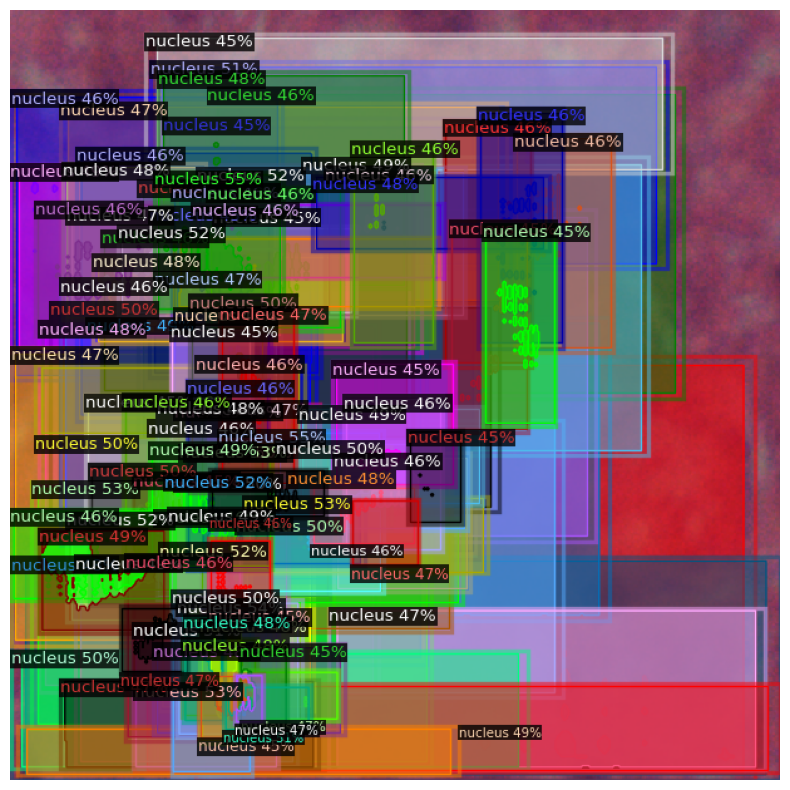

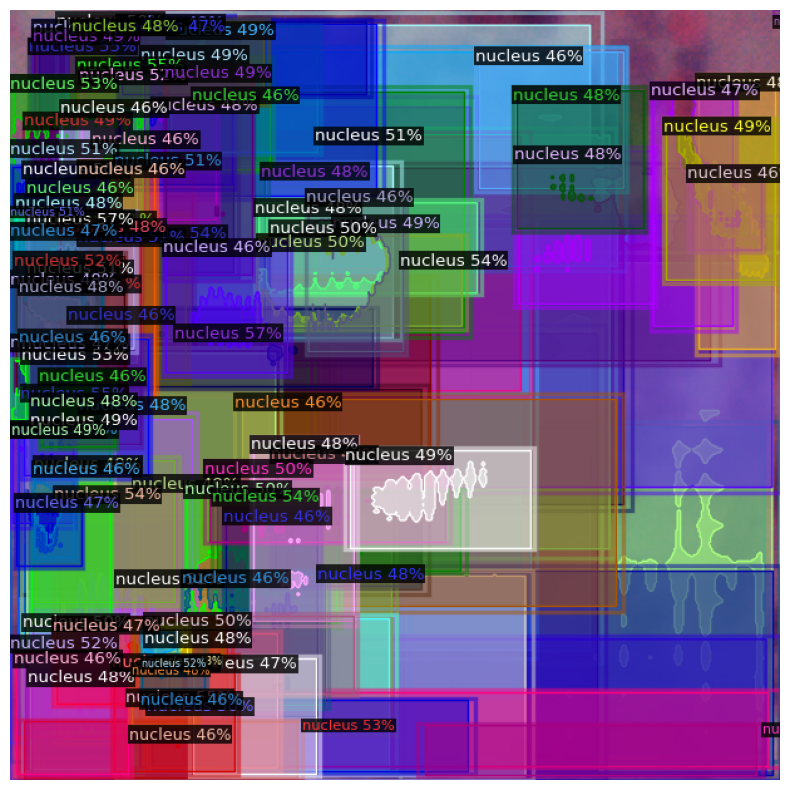

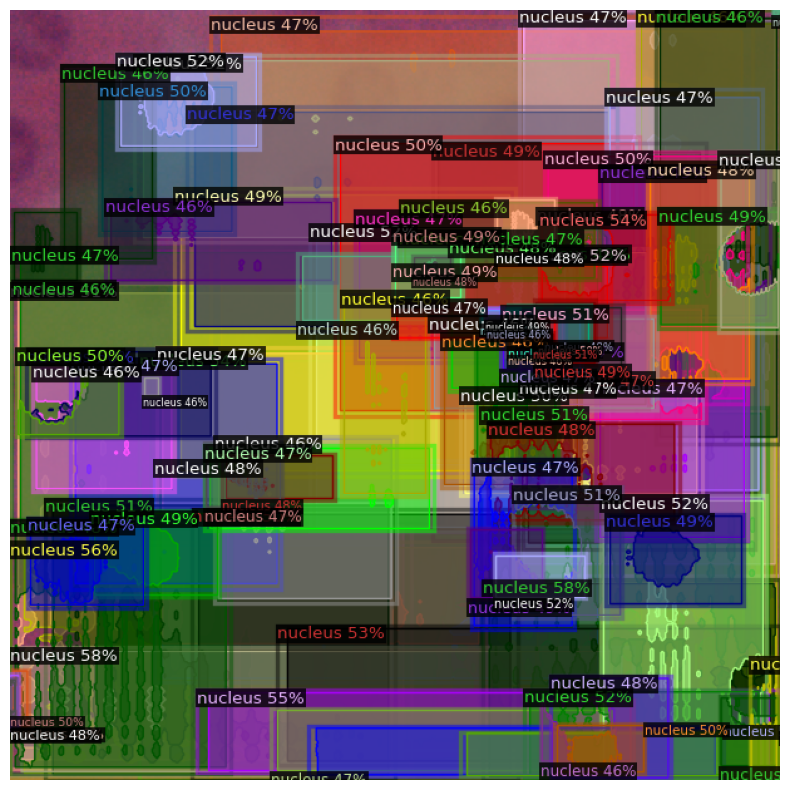

In [25]:
from detectron2.utils.visualizer import ColorMode

predictor = DefaultPredictor(cfg)

for d in random.sample(nuinsseg_dicts["val"], 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    instances = outputs["instances"].to("cpu")

    v = Visualizer(
        im[:, :, ::-1],  # BGR → RGB
        metadata=nuinsseg_metadata,
        scale=1.2,
        instance_mode=ColorMode.SEGMENTATION  # маски будут цветные, фон - оригинал
    )
    out = v.draw_instance_predictions(instances)
    plt.figure(figsize=(10, 10))
    plt.imshow(out.get_image())
    plt.axis("off")
    plt.show()
